In [11]:
import numpy as np
import pandas as pd
import scipy
from scipy import stats
import datetime as dt
import suncalc

import matplotlib.pyplot as plt
from matplotlib import colors
import soundfile as sf
import matplotlib.patches as patches
from pathlib import Path

In [2]:
import sys

sys.path.append("../src")
sys.path.append("../src/activity")

In [10]:
from core import SITE_NAMES, FREQ_GROUPS, SEATTLE_LATITUDE, SEATTLE_LONGITUDE
from cli import get_file_paths

import subsampling as ss
import plot
import pipeline
import activity_assembly as actvt

In [4]:
avail = np.arange(0, 720, 6) + 6
reset_24 = avail[np.where((24*60 % avail) == 0)[0]]
reset_24

array([  6,  12,  18,  24,  30,  36,  48,  60,  72,  90,  96, 120, 144,
       180, 240, 288, 360, 480, 720])

In [5]:
cycle_lengths = [10]
percent_ons = [1/2]
specific_dc_tag = "30of30"

data_params = dict()
data_params["cycle_lengths"] = cycle_lengths
data_params["percent_ons"] = percent_ons
dc_tags = ss.get_list_of_dc_tags(data_params["cycle_lengths"], data_params["percent_ons"])
data_params["dc_tags"] = dc_tags
data_params["cur_dc_tag"] = specific_dc_tag
data_params['bin_size'] = '30'
data_params['recording_start'] = '00:00'
data_params['recording_end'] = '16:00'

pipeline_params = dict()
pipeline_params['assemble_location_summary'] = False
pipeline_params["read_csv"] = False
pipeline_params['use_threshold_to_group'] = False
pipeline_params['use_kmeans_to_group'] = True
pipeline_params["save_activity_grid"] = False
pipeline_params["save_presence_grid"] = False
pipeline_params["save_dc_night_comparisons"] = False
pipeline_params["save_activity_dc_comparisons"] = False
pipeline_params["save_presence_dc_comparisons"] = False
pipeline_params["show_plots"] = True
pipeline_params["show_PST"] = True

site_key = 'Carp'
# for type_key in ['', 'LF', 'HF']:
type_key = 'LF'
print(site_key, type_key)

data_params["site_name"] = SITE_NAMES[site_key]
data_params["site_tag"] = site_key
data_params["type_tag"] = type_key

file_paths = get_file_paths(data_params)

activity_bouts_arr = pipeline.run_for_bouts(data_params, pipeline_params, file_paths)

Carp LF


In [6]:
activity_bouts_arr

,bout_time (30of30),bout_time (5of10)
datetime_UTC,,
2022-07-13 00:00:00,0.000000,0.000000
2022-07-13 00:30:00,0.000000,0.000000
2022-07-13 01:00:00,0.000000,0.000000
2022-07-13 01:30:00,0.000000,0.000000
2022-07-13 02:00:00,0.000000,0.000000
...,...,...
2022-10-17 13:30:00,0.802483,1.604967
2022-10-17 14:00:00,0.000000,0.000000
2022-10-17 14:30:00,0.000000,0.000000


In [7]:
activity_bouts_arr['bout_time (5of10)'].dropna().sort_values()

datetime_UTC
2022-07-13 00:00:00     0.000000
2022-09-11 00:00:00     0.000000
2022-09-11 00:30:00     0.000000
2022-09-11 01:00:00     0.000000
2022-09-11 01:30:00     0.000000
                         ...    
2022-09-01 04:30:00    95.128955
2022-09-01 03:30:00    95.431533
2022-09-14 03:30:00    95.618200
2022-09-01 04:00:00    96.951111
2022-08-11 04:30:00    98.261867
Name: bout_time (5of10), Length: 2849, dtype: float64

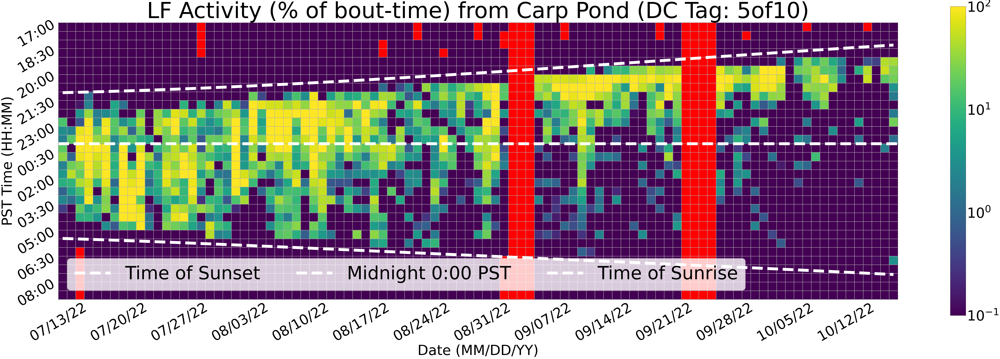

In [8]:
data_params["cur_dc_tag"] = '5of10'
plot.plot_activity_grid_for_bouts(activity_bouts_arr, data_params, pipeline_params, file_paths)
# plot.plot_dc_presence_comparisons_per_scheme(activity_bouts_arr, data_params, pipeline_params, file_paths)

In [39]:
"""
Plots an activity grid generated from an activity summary for a specific duty-cycling scheme.
The activity summary here is of the % of time occupied by bouts per date and time interval.
"""
activity_df = actvt.construct_activity_grid_for_bouts(activity_bouts_arr, data_params['cur_dc_tag'])

activity_times = pd.DatetimeIndex(activity_df.index).tz_localize('UTC')
activity_dates = pd.DatetimeIndex(activity_df.columns).strftime("%m/%d/%y")
ylabel = 'UTC'
if pipeline_params["show_PST"]:
    activity_times = activity_times.tz_convert(tz='US/Pacific')
    ylabel = 'PST'
activity_times = activity_times.strftime("%H:%M")
plot_times = [''] * len(activity_times)
# plot_times[2::4] = activity_times[2::4]
plot_dates = [''] * len(activity_dates)
# plot_dates[::7] = activity_dates[::7]

dates_for_sunrise_sunset = pd.to_datetime(activity_df.columns.values, format='%m/%d/%y')
activity_lat = [SEATTLE_LATITUDE]*len(dates_for_sunrise_sunset)
activity_lon = [SEATTLE_LONGITUDE]*len(dates_for_sunrise_sunset)
sunrise_time = pd.DatetimeIndex(suncalc.get_times(dates_for_sunrise_sunset, activity_lon, activity_lat)['sunrise_end'])
sunset_time = pd.DatetimeIndex(suncalc.get_times(dates_for_sunrise_sunset, activity_lon, activity_lat)['sunset_start'])
sunrise_seconds_from_midnight = sunrise_time.hour * 3600 + sunrise_time.minute*60 + sunrise_time.second
sunset_seconds_from_midnight = sunset_time.hour * 3600 + sunset_time.minute*60 + sunset_time.second

# activity_df[activity_df<20] = 0
activity_df

Date (UTC),07/13/22,07/14/22,07/15/22,07/16/22,07/17/22,07/18/22,07/19/22,07/20/22,07/21/22,07/22/22,...,10/08/22,10/09/22,10/10/22,10/11/22,10/12/22,10/13/22,10/14/22,10/15/22,10/16/22,10/17/22
Time (UTC),,,,,,,,,,,,,,,,,,,,,
00:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,NaN,0.000000,0.000000,0.000000
00:30,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
01:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
01:30,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
02:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,4.055856,10.513489,3.273944,0.959167,0.0,0.000000,0.246667,0.147944,22.577722,19.776011
02:30,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,20.582933,8.281233,7.380855,0.461511,0.0,3.864656,22.902933,0.000000,28.483867,13.226778
03:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,23.632322,67.801355,10.942900,1.502367,0.0,0.000000,27.703822,0.000000,8.804022,11.520267
03:30,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,14.920144,15.373489,25.709044,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,1.593156
04:00,0.000000,0.000000,0.000000,0.571878,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,9.464744,19.380889,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.813600


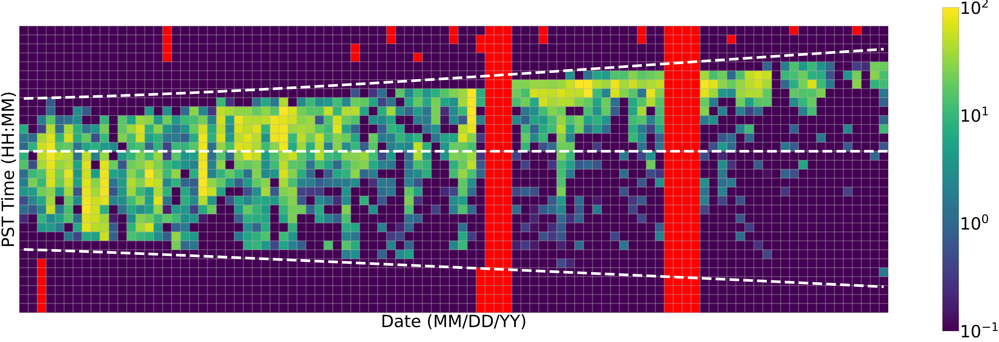

In [41]:

# on = int(data_params['cur_dc_tag'].split('of')[0])
# total = int(data_params['cur_dc_tag'].split('of')[1])
# bin_size = int(data_params['bin_size'])
# recover_ratio = min(total, bin_size) / min(on, bin_size)

# if total-on >= bin_size:
#     activity_df = activity_df.replace(np.NaN, -1).replace(0, np.NaN)
#     activity_df = activity_df.ffill(limit=(min((14*60)-on, total-on)//bin_size))
#     activity_df = activity_df.replace(np.NaN, 0).replace(-1, np.NaN)

masked_array_for_nodets = np.ma.masked_where(activity_df.values==np.NaN, activity_df.values)
cmap = plt.get_cmap('viridis')
cmap.set_bad(color='red')

plt.rcParams.update({'font.size': (0.8*len(activity_dates) + 0.8*len(activity_times))})
plt.figure(figsize=(1*len(activity_dates), 1*len(activity_times)))
title = f"{data_params['type_tag']} Activity (% of bout-time) from {data_params['site_name']} (DC Tag: {data_params['cur_dc_tag']})"
# plt.title(title, fontsize=0.8*len(activity_dates) + 1.4*len(activity_times))
plt.imshow(0.1+(masked_array_for_nodets), cmap=cmap, norm=colors.LogNorm(vmin=0.1, vmax=100))
# plt.imshow(0.1+(masked_array_for_nodets), cmap=cmap)
plt.plot(np.arange(0, len(plot_dates)), ((sunset_seconds_from_midnight / (30*60)) % len(plot_times)) - 0.5, 
        color='white', linewidth=0.5*len(activity_times), linestyle='dashed', label=f'Time of Sunset')
plt.axhline(y=np.where(activity_times=='00:00')[0]-0.5, linewidth=0.5*len(activity_times), linestyle='dashed', color='white', label='Midnight 0:00 PST')
plt.plot(np.arange(0, len(plot_dates)), ((sunrise_seconds_from_midnight / (30*60)) % len(plot_times)) - 0.5, 
        color='white', linewidth=0.5*len(activity_times), linestyle='dashed', label=f'Time of Sunrise')
plt.yticks(np.arange(0, len(activity_df.index))-0.5, plot_times, rotation=30)
plt.xticks(np.arange(0, len(activity_df.columns))-0.5, plot_dates, rotation=30)
plt.ylabel(f'{ylabel} Time (HH:MM)')
plt.xlabel('Date (MM/DD/YY)')
plt.grid(which='both', linewidth=6, alpha=0.4)
# plt.legend(loc=3, ncol=3, fontsize=0.7*len(activity_dates) + 1*len(activity_times))
plt.colorbar()
plt.tight_layout()
if pipeline_params["save_activity_grid"]:
    plt.savefig(f'{file_paths["activity_grid_folder"]}/{file_paths["activity_bouts_grid_figname"]}.png', bbox_inches='tight')
    plt.close()
if pipeline_params["show_plots"]:
    plt.show()

In [6]:
cycle_lengths = [6, 30]
percent_ons = [1/3]
specific_dc_tag = "30of30"

data_params = dict()
data_params["cycle_lengths"] = cycle_lengths
data_params["percent_ons"] = percent_ons
dc_tags = ss.get_list_of_dc_tags(data_params["cycle_lengths"], data_params["percent_ons"])
data_params["dc_tags"] = dc_tags
data_params["cur_dc_tag"] = specific_dc_tag
data_params['bin_size'] = '30'
data_params['recording_start'] = '00:00'
data_params['recording_end'] = '16:00'

pipeline_params = dict()
pipeline_params['assemble_location_summary'] = False
pipeline_params["read_csv"] = False
pipeline_params['use_threshold_to_group'] = False
pipeline_params['use_kmeans_to_group'] = True
pipeline_params["save_activity_grid"] = False
pipeline_params["save_presence_grid"] = False
pipeline_params["save_dc_night_comparisons"] = False
pipeline_params["save_activity_dc_comparisons"] = False
pipeline_params["save_presence_dc_comparisons"] = False
pipeline_params["show_plots"] = True
pipeline_params["show_PST"] = True

site_key = 'Carp'
for type_key in ['', 'LF', 'HF']:
    print(site_key, type_key)

    data_params["site_name"] = SITE_NAMES[site_key]
    data_params["site_tag"] = site_key
    data_params["type_tag"] = type_key

    file_paths = get_file_paths(data_params)

    activity_bouts_arr = pipeline.run_for_bouts(data_params, pipeline_params, file_paths)
    plot.plot_dc_bout_activity_comparisons_per_scheme(activity_bouts_arr, data_params, pipeline_params, file_paths)
    # plot.plot_dc_presence_comparisons_per_scheme(activity_bouts_arr, data_params, pipeline_params, file_paths)

Carp 


Carp LF


In [ ]:
cycle_lengths = [6, 30]
percent_ons = [1/2]
specific_dc_tag = "30of30"

data_params = dict()
data_params["cycle_lengths"] = cycle_lengths
data_params["percent_ons"] = percent_ons
dc_tags = ss.get_list_of_dc_tags(data_params["cycle_lengths"], data_params["percent_ons"])
data_params["dc_tags"] = dc_tags
data_params["cur_dc_tag"] = specific_dc_tag
data_params['bin_size'] = '30'
data_params['recording_start'] = '00:00'
data_params['recording_end'] = '16:00'

pipeline_params = dict()
pipeline_params['assemble_location_summary'] = False
pipeline_params["read_csv"] = False
pipeline_params['use_threshold_to_group'] = False
pipeline_params['use_kmeans_to_group'] = True
pipeline_params["save_activity_grid"] = False
pipeline_params["save_presence_grid"] = False
pipeline_params["save_dc_night_comparisons"] = False
pipeline_params["save_activity_dc_comparisons"] = False
pipeline_params["save_presence_dc_comparisons"] = False
pipeline_params["show_plots"] = True
pipeline_params["show_PST"] = True

site_key = 'Carp'
for type_key in ['', 'LF', 'HF']:
    print(site_key, type_key)

    data_params["site_name"] = SITE_NAMES[site_key]
    data_params["site_tag"] = site_key
    data_params["type_tag"] = type_key

    file_paths = get_file_paths(data_params)

    activity_bouts_arr = pipeline.run_for_bouts(data_params, pipeline_params, file_paths)
    plot.plot_dc_bout_activity_comparisons_per_scheme(activity_bouts_arr, data_params, pipeline_params, file_paths)
    # plot.plot_dc_presence_comparisons_per_scheme(activity_bouts_arr, data_params, pipeline_params, file_paths)

Carp 


Carp LF


Carp HF


In [ ]:
cycle_lengths = [6, 30]
percent_ons = [1/6]
specific_dc_tag = "30of30"

data_params = dict()
data_params["cycle_lengths"] = cycle_lengths
data_params["percent_ons"] = percent_ons
dc_tags = ss.get_list_of_dc_tags(data_params["cycle_lengths"], data_params["percent_ons"])
data_params["dc_tags"] = dc_tags
data_params["cur_dc_tag"] = specific_dc_tag
data_params['bin_size'] = '30'
data_params['recording_start'] = '00:00'
data_params['recording_end'] = '16:00'

pipeline_params = dict()
pipeline_params['assemble_location_summary'] = False
pipeline_params["read_csv"] = False
pipeline_params['use_threshold_to_group'] = False
pipeline_params['use_kmeans_to_group'] = True
pipeline_params["save_activity_grid"] = False
pipeline_params["save_presence_grid"] = False
pipeline_params["save_dc_night_comparisons"] = False
pipeline_params["save_activity_dc_comparisons"] = False
pipeline_params["save_presence_dc_comparisons"] = False
pipeline_params["show_plots"] = True
pipeline_params["show_PST"] = True

site_key = 'Carp'
for type_key in ['', 'LF', 'HF']:
    print(site_key, type_key)

    data_params["site_name"] = SITE_NAMES[site_key]
    data_params["site_tag"] = site_key
    data_params["type_tag"] = type_key

    file_paths = get_file_paths(data_params)

    activity_bouts_arr = pipeline.run_for_bouts(data_params, pipeline_params, file_paths)
    plot.plot_dc_bout_activity_comparisons_per_scheme(activity_bouts_arr, data_params, pipeline_params, file_paths)
    # plot.plot_dc_presence_comparisons_per_scheme(activity_bouts_arr, data_params, pipeline_params, file_paths)

Carp 


Carp LF


Carp HF
